# Quality Classification of Germinated Oil Palm Seeds

Dataset is classified.

## Mount Google Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [ ]:
%cd /content/drive/My Drive/

/content/drive/My Drive


In [ ]:
from matplotlib.colors import Colormap
import cv2
import os
from google.colab.patches import cv2_imshow
import csv
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
cwd = os.getcwd()

## Read CSV Files

In [ ]:
list_good_seeds = sorted(os.listdir(os.path.join(cwd, 'Group3_Dataset/b1/shared_b1segment/train/GoodSeed')))
list_bad_seeds = sorted(os.listdir(os.path.join(cwd, 'Group3_Dataset/b1/shared_b1segment/train/BadSeed')))
print(f'Total number of bad seeds: {len(list_bad_seeds)}')
total_number = len(list_good_seeds) + len(list_bad_seeds)
print(f'Total number of seeds: {total_number}')

Total number of bad seeds: 851
Total number of seeds: 1752


In [ ]:
csvpath = os.path.join(cwd, 'Group3_Dataset/b1/b1_segmentTrainData.csv')
df = pd.read_csv(csvpath)
num_rows = len(df)
print(f'The Train CSV file contains {num_rows} rows.')

The Train CSV file contains 1752 rows.


In [ ]:
csvpath = os.path.join(cwd, 'Group3_Dataset/b1/train.csv')
train_df = pd.read_csv(csvpath)
num_rows = len(train_df)
print(f'The train in Train CSV file contains {num_rows} rows.')

The train in Train CSV file contains 1401 rows.


In [ ]:
csvpath = os.path.join(cwd, 'Group3_Dataset/b1/validation.csv')
val_df = pd.read_csv(csvpath)
num_rows = len(val_df)
print(f'The validation in Train CSV file contains {num_rows} rows.')

The validation in Train CSV file contains 351 rows.


In [ ]:
csvpath = os.path.join(cwd, 'Group3_Dataset/b1/b1_segmentTestData.csv')
test_df = pd.read_csv(csvpath)
num_rows = len(test_df)
print(f'The Test CSV file contains {num_rows} rows.')

The Test CSV file contains 401 rows.


In [ ]:
total_size = df.shape[0]


train_size = train_df.shape[0] / total_size
val_size = val_df.shape[0] / total_size

print("Sizes as a percentage of the original dataset:")
print(f"Train size: {train_size:.2%}")
print(f"Validation size: {val_size:.2%}")

Sizes as a percentage of the original dataset:
Train size: 79.97%
Validation size: 20.03%


In [ ]:
csvpath = os.path.join(cwd, 'Group3_Dataset/b2/b2.csv')
b2_df = pd.read_csv(csvpath)
num_rows = len(b2_df)
print(f'The b2 CSV file contains {num_rows} rows.')

The b2 CSV file contains 900 rows.


In [ ]:
csvpath = os.path.join(cwd, 'Group3_Dataset/b3/b3.csv')
b3_df = pd.read_csv(csvpath)
num_rows = len(b3_df)
print(f'The b3 CSV file contains {num_rows} rows.')

The b3 CSV file contains 1198 rows.


## Load Data

In [ ]:
from torch.utils.data import Dataset
from torchvision import datasets
from torchvision.io import read_image
from torch.utils.data import DataLoader
from torchvision.io import read_image
import torchvision.transforms as transforms

In [ ]:
transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.ToTensor(),
    transforms.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))
])

In [ ]:
class myDataset(Dataset):
    def __init__(self, annotations_file, img_dir, transform=transform, target_transform=None):
        self.img_labels = annotations_file
        self.img_dir = img_dir
        self.transform = transform
        self.target_transform = target_transform

    def __len__(self):
        return len(self.img_labels)

    def __getitem__(self, idx):
        label = self.img_labels.iloc[idx, 1]
        if label == 1:
          img_path = os.path.join(self.img_dir, 'GoodSeed', self.img_labels.iloc[idx, 0])
        elif label == 0:
          img_path = os.path.join(self.img_dir, 'BadSeed', self.img_labels.iloc[idx, 0])
        if not os.path.exists(img_path):
           raise Exception('The path {} does not exist!'.format(img_path))
        image = read_image(img_path)

        if self.transform:
            image = self.transform(image)
        if self.target_transform:
            label = self.target_transform(label)
        return image, label

In [ ]:
train_root_path = os.path.join(cwd, 'Group3_Dataset/b1/shared_b1segment/train')
test_root_path = os.path.join(cwd, 'Group3_Dataset/b1/shared_b1segment/test')

In [ ]:
b2_root_path = os.path.join(cwd, 'Group3_Dataset/b2')

In [ ]:
b3_root_path = os.path.join(cwd, 'Group3_Dataset/b3')

In [ ]:
print('Loading training dataset...')
training_data = myDataset(train_df, train_root_path)
print('Training dataset loaded!')

Loading training dataset...
Training dataset loaded!


In [ ]:
print('Loading validation dataset...')
val_data = myDataset(val_df, train_root_path)
print('Validation dataset loaded!')

Loading validation dataset...
Validation dataset loaded!


In [ ]:
print('Loading testing dataset...')
test_data = myDataset(test_df, test_root_path)
print('Testing dataset loaded!')

Loading testing dataset...
Testing dataset loaded!


In [ ]:
print('Loading b2 dataset...')
b2_data = myDataset(b2_df, b2_root_path)
print('b2 dataset loaded!')

Loading b2 dataset...
b2 dataset loaded!


In [ ]:
print('Loading b3 dataset...')
b3_data = myDataset(b3_df, b3_root_path)
print('b3 dataset loaded!')

Loading b3 dataset...
b3 dataset loaded!


## Data Augmentation

In [ ]:
import torchvision.transforms as transforms

In [ ]:
# Define the transform pipeline for data augmentation
augmented_transform = transforms.Compose([
      transforms.ToPILImage(),
      transforms.RandomCrop(256, padding=4),
      transforms.RandomHorizontalFlip(),
      transforms.ToTensor(),
      transforms.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225)),
])

# Apply the transform pipeline to the training set
augmented_dataset = myDataset(train_df, train_root_path, transform=augmented_transform)

In [ ]:
import torch
combined_training_data = torch.utils.data.ConcatDataset([training_data, augmented_dataset])

In [ ]:
combined_size = len(combined_training_data)
print(f'Combined Augmented Training Data Size: {combined_size}')

Combined Augmented Training Data Size: 2802


## Use DataLoader for Minibatches

In [ ]:
from torch.utils.data import DataLoader

In [ ]:
train_dataloader = DataLoader(training_data, batch_size=32, shuffle=True, num_workers=2)
val_dataloader = DataLoader(val_data, batch_size=32, shuffle=True, num_workers=2)
test_dataloader = DataLoader(test_data, batch_size=32, shuffle=False, num_workers=2)
combined_train_dataloader = DataLoader(combined_training_data, batch_size=32, shuffle=True, num_workers=2)

In [ ]:
b2_dataloader = DataLoader(b2_data, batch_size=32, shuffle=False, num_workers=2)

In [ ]:
b3_dataloader = DataLoader(b3_data, batch_size=32, shuffle=False, num_workers=2)

Feature batch shape: torch.Size([32, 3, 256, 256])
Labels batch shape: torch.Size([32])


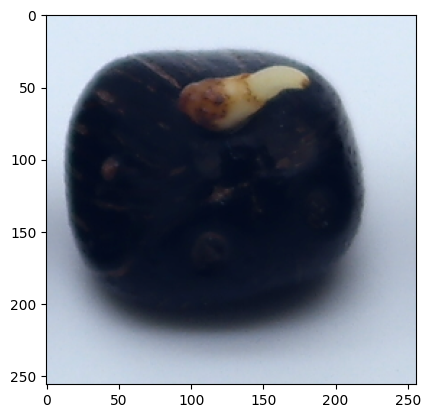

Label: 0


In [ ]:
train_features, train_labels = next(iter(train_dataloader))
print(f"Feature batch shape: {train_features.size()}")
print(f"Labels batch shape: {train_labels.size()}")
img = train_features[0].squeeze()
label = train_labels[0]
img_min = img.min()
img_max = img.max()
img_norm = (img - img_min) / (img_max - img_min)
plt.imshow(img_norm.permute(1,2,0))
plt.show()
print(f"Label: {label}")

In [ ]:
# Check the type of elements in the train loader
train_loader_iter = iter(train_dataloader)
data, labels = next(train_loader_iter)
print(type(data))
print(type(labels))

# Check the type of elements in the combined train loader
combined_train_loader_iter = iter(combined_train_dataloader)
data, labels = next(combined_train_loader_iter)
print(type(data))
print(type(labels))

<class 'torch.Tensor'>
<class 'torch.Tensor'>
<class 'torch.Tensor'>
<class 'torch.Tensor'>


## Our CNN Model

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.nn.init as init
import torchvision
import torchvision.transforms as transforms

In [ ]:
class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()
        
        self.conv1 = nn.Conv2d(in_channels=3, out_channels=16, kernel_size=3, stride=1, padding=1)
        self.pool = torch.nn.MaxPool2d(kernel_size=2, stride=2)
        self.bn1 = nn.BatchNorm2d(16)
        self.conv2 = nn.Conv2d(in_channels=16, out_channels=32, kernel_size=3, stride=1, padding=1)
        self.bn2 = nn.BatchNorm2d(32)
        self.conv3 = nn.Conv2d(in_channels=32, out_channels=64, kernel_size=3, stride=1, padding=1)
        self.bn3 = nn.BatchNorm2d(64)
        self.fc1 = nn.Linear(in_features=64*32*32, out_features=128)
        self.bn4 = nn.BatchNorm1d(128)
        self.dropout = nn.Dropout(p=dropout_rate)
        self.fc2 = nn.Linear(in_features=128, out_features=2)

    def forward(self, x):
        x = self.pool(nn.functional.relu(self.bn1(self.conv1(x))))
        x = self.pool(nn.functional.relu(self.bn2(self.conv2(x))))
        x = self.pool(nn.functional.relu(self.bn3(self.conv3(x))))
        x = x.view(x.size(0), -1) # Flatten Layer
        x = nn.functional.relu(self.bn4(self.fc1(x)))
        x = self.dropout(x)
        x = self.fc2(x)
        
        return x
    
    def initialize_weights(self):
        for layer in self.modules():
            if isinstance(layer, torch.nn.Conv2d) or isinstance(layer, torch.nn.Linear):
                init.kaiming_uniform_(layer.weight)
                if layer.bias is not None:
                    init.constant_(layer.bias, 0)



In [ ]:
learningRate = 0.001
momentum  = 0.9
numEpoch = 50
dropout_rate = 0.3
step_size = 15
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [ ]:
net = Net().to(device) 
criterion = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(net.parameters(), lr=learningRate)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=0.1)

### Training

In [ ]:
net.initialize_weights()

In [ ]:
train_losses = []
val_losses = []
best_val_accuracy = 0.0
best_val_loss = float('inf')
no_improvement_count = 0
patience = 10 # number of epochs to wait for improvement before stopping

for epoch in range(numEpoch):
    running_loss = 0.0
    for i, data in enumerate(combined_train_dataloader, 0):
        inputs, labels = data[0].to(device).to(torch.float32), data[1].to(device)

        optimizer.zero_grad()

        outputs = net(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

    # Validate the model on the validation set
    net.eval()
    val_loss = 0.0
    val_correct = 0
    val_total = 0
    with torch.no_grad():
        for data in val_dataloader:
            images, labels = data[0].to(device).to(torch.float32), data[1].to(device)
            outputs = net(images)
            _, predicted = torch.max(outputs.data, 1)
            val_total += labels.size(0)
            val_correct += (predicted == labels).sum().item()
            loss = criterion(outputs, labels)
            val_loss += loss.item()

    val_accuracy = 100 * val_correct / val_total
    val_loss /= len(val_dataloader)
    print('Epoch %d -- Train Loss: %.3f | Val Loss: %.3f | Val Acc: %.2f%%' % (epoch + 1, running_loss / len(combined_train_dataloader), val_loss, val_accuracy))

    train_losses.append(running_loss / len(combined_train_dataloader))
    val_losses.append(val_loss)

    if val_loss < best_val_loss:
        best_val_loss = val_loss
        torch.save(net.state_dict(), 'model.pth')
        no_improvement_count = 0
    else:
        no_improvement_count += 1
        if no_improvement_count >= patience:
            print('Early stopping at epoch %d' % (epoch + 1))
            break

    scheduler.step()


Epoch 1 -- Train Loss: 0.709 | Val Loss: 1.384 | Val Acc: 57.83%
Epoch 2 -- Train Loss: 0.471 | Val Loss: 0.253 | Val Acc: 88.60%
Epoch 3 -- Train Loss: 0.216 | Val Loss: 0.192 | Val Acc: 92.88%
Epoch 4 -- Train Loss: 0.150 | Val Loss: 0.228 | Val Acc: 90.60%
Epoch 5 -- Train Loss: 0.123 | Val Loss: 0.168 | Val Acc: 94.02%
Epoch 6 -- Train Loss: 0.082 | Val Loss: 0.145 | Val Acc: 94.59%
Epoch 7 -- Train Loss: 0.060 | Val Loss: 0.139 | Val Acc: 94.30%
Epoch 8 -- Train Loss: 0.079 | Val Loss: 0.136 | Val Acc: 96.01%
Epoch 9 -- Train Loss: 0.050 | Val Loss: 0.133 | Val Acc: 95.44%
Epoch 10 -- Train Loss: 0.040 | Val Loss: 0.158 | Val Acc: 94.02%
Epoch 11 -- Train Loss: 0.049 | Val Loss: 0.163 | Val Acc: 94.02%
Epoch 12 -- Train Loss: 0.050 | Val Loss: 0.191 | Val Acc: 94.02%
Epoch 13 -- Train Loss: 0.035 | Val Loss: 0.172 | Val Acc: 94.87%
Epoch 14 -- Train Loss: 0.020 | Val Loss: 0.190 | Val Acc: 93.45%
Epoch 15 -- Train Loss: 0.018 | Val Loss: 0.208 | Val Acc: 93.73%
Epoch 16 -- Train L

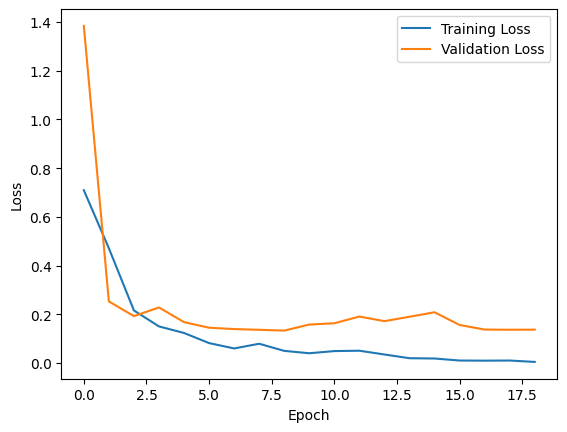

In [ ]:
# Plot the training and validation losses over epochs
plt.plot(train_losses, label='Training Loss')
plt.plot(val_losses, label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

### Batch 1

#### Quantitative Result

In [ ]:
import numpy as np
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix

# Initialize empty lists to store true and predicted labels
true_labels = []
predicted_labels = []

# Evaluate model on test set
best_model = Net()
best_model.load_state_dict(torch.load('model.pth'))
best_model.to(device)
best_model.eval()

with torch.no_grad():
    for data in test_dataloader:
        images, labels = data[0].to(device).to(torch.float32), data[1].to(device)
        outputs = best_model(images)
        _, predicted = torch.max(outputs.data, 1)
        predicted_labels += predicted.cpu().numpy().tolist()
        true_labels += labels.cpu().numpy().tolist()

# Compute evaluation metrics
accuracy = accuracy_score(true_labels, predicted_labels)
precision = precision_score(true_labels, predicted_labels, pos_label=1)
recall = recall_score(true_labels, predicted_labels, pos_label=1)
f1 = f1_score(true_labels, predicted_labels, pos_label=1)
auc = roc_auc_score(true_labels, predicted_labels)

# Compute confusion matrix
confusion = confusion_matrix(true_labels, predicted_labels, labels=[1, 0])

# Print evaluation metrics
print('Overall Accuracy: %.2f%%'% (accuracy * 100))
print('Overall Precision: %.2f%%'% (precision * 100))
print('Overall Recall: %.2f%%'% (recall * 100))
print('Overall F1-score: %.2f%%'% (f1 * 100))
print('Overall AUC: %.2f%%'% (auc * 100))
print()

# Print confusion matrix
print('Confusion Matrix:')
print(confusion)
print()

# Calculate precision, recall, accuracy, and F1-score for each class
class_names = ['Good Seed', 'Bad Seed']
metrics = {}
for i in range(len(class_names)):
    TP = confusion[i][i]
    FN = sum(confusion[i]) - TP
    FP = sum(confusion[:, i]) - TP
    TN = sum(sum(confusion)) - TP - FN - FP
    accuracy = (TP + TN) / (TP + TN + FP + FN)
    precision = TP / (TP + FP)
    recall = TP / (TP + FN)
    f1 = 2 * precision * recall / (precision + recall)
    metrics[class_names[i]] = {'Accuracy': accuracy, 'Precision': precision, 'Recall': recall, 'F1-score': f1}

# Print individual metrics
for class_name, class_metrics in metrics.items():
    print(f'{class_name} Metrics:')
    print('---------------------')
    print('Accuracy: %.2f%%' % (class_metrics['Accuracy'] * 100))
    print('Precision: %.2f%%' % (class_metrics['Precision'] * 100))
    print('Recall: %.2f%%' % (class_metrics['Recall'] * 100))
    print('F1-score: %.2f%%' % (class_metrics['F1-score'] * 100))
    print()


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f1dda0a3280>
Traceback (most recent call last):
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f1dda0a3280>  File "/usr/local/lib/python3.9/dist-packages/torch/utils/data/dataloader.py", line 1479, in __del__
    self._shutdown_workers()
Traceback (most recent call last):
  File "/usr/local/lib/python3.9/dist-packages/torch/utils/data/dataloader.py", line 1479, in __del__

  File "/usr/local/lib/python3.9/dist-packages/torch/utils/data/dataloader.py", line 1462, in _shutdown_workers
    self._shutdown_workers()    
if w.is_alive():
  File "/usr/local/lib/python3.9/dist-packages/torch/utils/data/dataloader.py", line 1462, in _shutdown_workers
  File "/usr/lib/python3.9/multiprocessing/process.py", line 160, in is_alive
        if w.is_alive():assert self._parent_pid == os.getpid(), 'can only test a child process'

AssertionError  File "/usr/lib/python3.9/multiprocessing/process.py"

Overall Accuracy: 96.26%
Overall Precision: 95.15%
Overall Recall: 97.51%
Overall F1-score: 96.31%
Overall AUC: 96.26%

Confusion Matrix:
[[196   5]
 [ 10 190]]

Good Seed Metrics:
---------------------
Accuracy: 96.26%
Precision: 95.15%
Recall: 97.51%
F1-score: 96.31%

Bad Seed Metrics:
---------------------
Accuracy: 96.26%
Precision: 97.44%
Recall: 95.00%
F1-score: 96.20%



In [ ]:
import torch
import matplotlib.pyplot as plt
import numpy as np
import torch.nn as nn
import cv2 as cv
import argparse
import requests
from torchvision import models, transforms

In [ ]:
model = best_model

In [ ]:
print(model)

Net(
  (conv1): Conv2d(3, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (bn1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv2): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv3): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (bn3): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (fc1): Linear(in_features=65536, out_features=128, bias=True)
  (bn4): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (dropout): Dropout(p=0.3, inplace=False)
  (fc2): Linear(in_features=128, out_features=2, bias=True)
)


#### Visualise Learned Weights


In [ ]:
model_weights = [] # we will save the conv layer weights in this list
conv_layers = [] # we will save the conv layers in this list
# get all the model children as list
model_children = list(model.children())

In [ ]:
# counter to keep count of the conv layers
counter = 0 
# append all the conv layers and their respective weights to the list
for i in range(len(model_children)):
    if type(model_children[i]) == nn.Conv2d:
        counter += 1
        model_weights.append(model_children[i].weight)
        conv_layers.append(model_children[i])
    elif type(model_children[i]) == nn.Sequential:
        for j in range(len(model_children[i])):
            for child in model_children[i][j].children():
                if type(child) == nn.Conv2d:
                    counter += 1
                    model_weights.append(child.weight)
                    conv_layers.append(child)
print(f"Total convolutional layers: {counter}")

Total convolutional layers: 3


In [ ]:
# take a look at the conv layers and the respective weights
for weight, conv in zip(model_weights, conv_layers):
    # print(f"WEIGHT: {weight} \nSHAPE: {weight.shape}")
    print(f"CONV: {conv} ====> SHAPE: {weight.shape}")

CONV: Conv2d(3, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)) ====> SHAPE: torch.Size([16, 3, 3, 3])
CONV: Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)) ====> SHAPE: torch.Size([32, 16, 3, 3])
CONV: Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)) ====> SHAPE: torch.Size([64, 32, 3, 3])


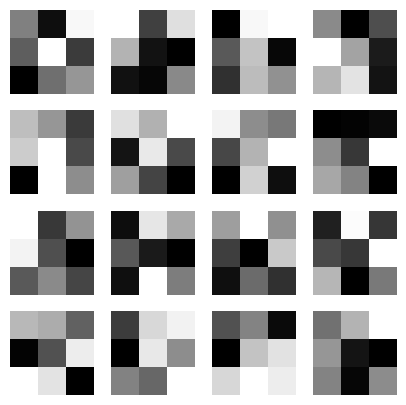

In [ ]:
plt.figure(figsize=(5, 5))
for i, filter in enumerate(model_weights[0]):
    plt.subplot(4, 4, i+1) # (2, 8) because in conv0 we have 3x3 filters and total of 16 (see printed shapes)
    plt.imshow(filter[0, :, :].detach().cpu().numpy(), cmap='gray')
    plt.axis('off')
plt.show()

#### Visualise Feature Map

In [ ]:
import random

In [ ]:
# Set random seed
random.seed(42)

# Get one batch of data
test_iter = iter(test_dataloader)
images, labels = next(test_iter)

# Get one random image and its corresponding label
index = random.randint(0, len(images)-1)
image = images[index]
label = labels[index]

In [ ]:
print(image.size())

torch.Size([3, 256, 256])


In [ ]:
# unsqueeze to add a batch dimension
image = image.unsqueeze(0)
print(image.size())

torch.Size([1, 3, 256, 256])


In [ ]:
# move image tensor to the same device as the weights
image = image.to(next(conv_layers[0].parameters()).device)

# pass the image through all the layers
results = [conv_layers[0](image)]
for i in range(1, len(conv_layers)):
    # pass the result from the last layer to the next layer
    results.append(conv_layers[i](results[-1]))
# make a copy of the `results`
outputs = results

In [ ]:
# visualize 64 features from each layer
def display_layer(num_layer):
    plt.figure(figsize=(30, 30))
    layer_viz = outputs[num_layer][0, :, :, :]
    layer_viz = layer_viz.cpu().data
    for i, filter in enumerate(layer_viz):
        if i == 64: # we will visualize only 8x8 blocks from each layer
            break
        plt.subplot(8, 8, i + 1)
        plt.imshow(filter, cmap='gray')
        plt.axis("off")

    plt.show()
    plt.close()
    print()

Layer 0 feature maps: 



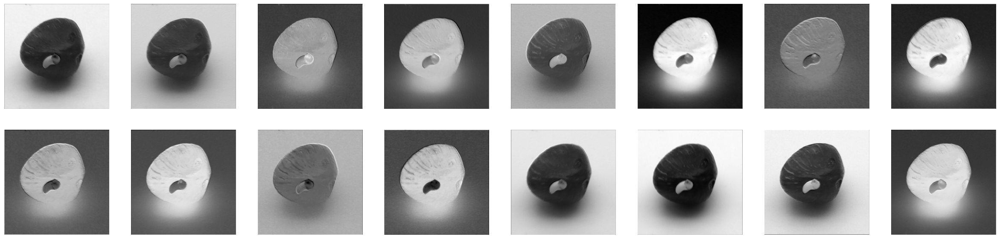

In [ ]:
print("Layer 0 feature maps: \n")
display_layer(0)

#### Visualise Saliency Map

In [ ]:
def saliency_map(img):
    device = next(model.parameters()).device # get the device of the model
    X = img.to(device) # move the input image to the same device as the model

    # we would run the model in evaluation mode
    model.eval()

    # we need to find the gradient with respect to the input image, so we need to call requires_grad_ on it
    X.requires_grad_()

    scores = model(X)

    # Get the index corresponding to the maximum score and the maximum score itself.
    score_max_index = scores.argmax()
    score_max = scores[0,score_max_index]

    score_max.backward()

    saliency, _ = torch.max(X.grad.data.abs().cpu(),dim=1)
    img = img.squeeze()
    img_min = img.min()
    img_max = img.max()
    img_norm = (img - img_min) / (img_max - img_min)
    plt.figure(figsize=(10,10))
    plt.subplot(1,2,1)
    plt.imshow(img_norm.cpu().detach().numpy().transpose(1,2,0))
    plt.axis("off")
    plt.subplot(1,2,2)
    plt.imshow(saliency[0], cmap=plt.cm.hot)
    plt.axis("off")
    plt.show()

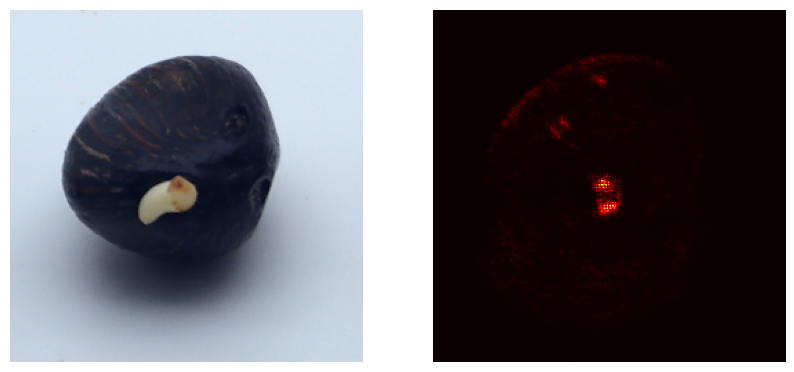

In [ ]:
saliency_map(image)

### Batch 2

#### Quantitative Result

In [ ]:
import numpy as np
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix

# Initialize empty lists to store true and predicted labels
true_labels = []
predicted_labels = []

# Evaluate model on test set
best_model = Net()
best_model.load_state_dict(torch.load('model.pth'))
best_model.to(device)
best_model.eval()

with torch.no_grad():
    for data in b2_dataloader:
        images, labels = data[0].to(device).to(torch.float32), data[1].to(device)
        outputs = best_model(images)
        _, predicted = torch.max(outputs.data, 1)
        predicted_labels += predicted.cpu().numpy().tolist()
        true_labels += labels.cpu().numpy().tolist()

# Compute evaluation metrics
accuracy = accuracy_score(true_labels, predicted_labels)
precision = precision_score(true_labels, predicted_labels, pos_label=1)
recall = recall_score(true_labels, predicted_labels, pos_label=1)
f1 = f1_score(true_labels, predicted_labels, pos_label=1)
auc = roc_auc_score(true_labels, predicted_labels)

# Compute confusion matrix
confusion = confusion_matrix(true_labels, predicted_labels, labels=[1, 0])

# Print evaluation metrics
print('Overall Accuracy: %.2f%%'% (accuracy * 100))
print('Overall Precision: %.2f%%'% (precision * 100))
print('Overall Recall: %.2f%%'% (recall * 100))
print('Overall F1-score: %.2f%%'% (f1 * 100))
print('Overall AUC: %.2f%%'% (auc * 100))
print()

# Print confusion matrix
print('Confusion Matrix:')
print(confusion)
print()

# Calculate precision, recall, accuracy, and F1-score for each class
class_names = ['Good Seed', 'Bad Seed']
metrics = {}
for i in range(len(class_names)):
    TP = confusion[i][i]
    FN = sum(confusion[i]) - TP
    FP = sum(confusion[:, i]) - TP
    TN = sum(sum(confusion)) - TP - FN - FP
    accuracy = (TP + TN) / (TP + TN + FP + FN)
    precision = TP / (TP + FP)
    recall = TP / (TP + FN)
    f1 = 2 * precision * recall / (precision + recall)
    metrics[class_names[i]] = {'Accuracy': accuracy, 'Precision': precision, 'Recall': recall, 'F1-score': f1}

# Print individual metrics
for class_name, class_metrics in metrics.items():
    print(f'{class_name} Metrics:')
    print('---------------------')
    print('Accuracy: %.2f%%' % (class_metrics['Accuracy'] * 100))
    print('Precision: %.2f%%' % (class_metrics['Precision'] * 100))
    print('Recall: %.2f%%' % (class_metrics['Recall'] * 100))
    print('F1-score: %.2f%%' % (class_metrics['F1-score'] * 100))
    print()


Overall Accuracy: 69.56%
Overall Precision: 62.29%
Overall Recall: 99.11%
Overall F1-score: 76.50%
Overall AUC: 69.56%

Confusion Matrix:
[[446   4]
 [270 180]]

Good Seed Metrics:
---------------------
Accuracy: 69.56%
Precision: 62.29%
Recall: 99.11%
F1-score: 76.50%

Bad Seed Metrics:
---------------------
Accuracy: 69.56%
Precision: 97.83%
Recall: 40.00%
F1-score: 56.78%



#### Visualise Feature Map

In [ ]:
# Set random seed
random.seed(42)

# Get one batch of data
b2_iter = iter(b2_dataloader)
images, labels = next(b2_iter)

# Get one random image and its corresponding label
index = random.randint(0, len(images)-1)
image_b2 = images[index]
label = labels[index]

In [ ]:
image_b2 = image_b2.unsqueeze(0)

In [ ]:
# move image tensor to the same device as the weights
image_b2 = image_b2.to(next(conv_layers[0].parameters()).device)

# pass the image through all the layers
results = [conv_layers[0](image_b2)]
for i in range(1, len(conv_layers)):
    # pass the result from the last layer to the next layer
    results.append(conv_layers[i](results[-1]))
# make a copy of the `results`
outputs = results

Layer 0 feature maps: 



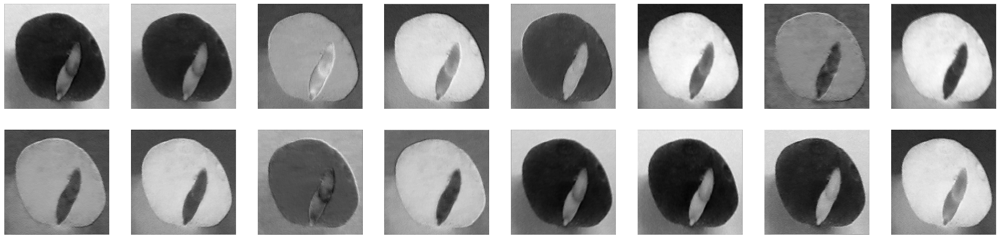

In [ ]:
print("Layer 0 feature maps: \n")
display_layer(0)

#### Visualise Saliency Map

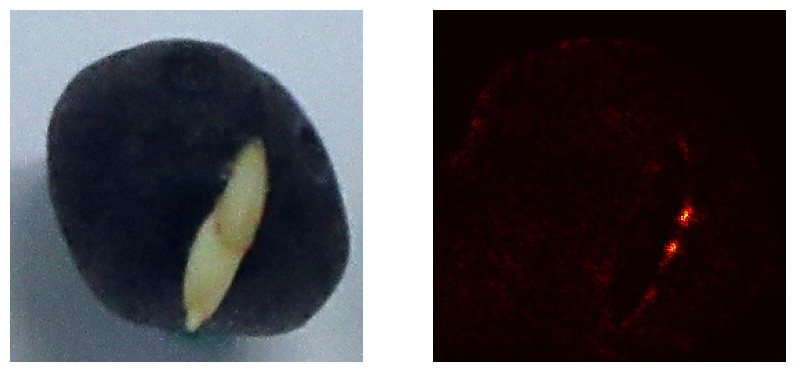

In [ ]:
saliency_map(image_b2)

### Batch 3

#### Quantitative Result

In [ ]:
import numpy as np
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix

# Initialize empty lists to store true and predicted labels
true_labels = []
predicted_labels = []

# Evaluate model on test set
best_model = Net()
best_model.load_state_dict(torch.load('model.pth'))
best_model.to(device)
best_model.eval()

with torch.no_grad():
    for data in b3_dataloader:
        images, labels = data[0].to(device).to(torch.float32), data[1].to(device)
        outputs = best_model(images)
        _, predicted = torch.max(outputs.data, 1)
        predicted_labels += predicted.cpu().numpy().tolist()
        true_labels += labels.cpu().numpy().tolist()

# Compute evaluation metrics
accuracy = accuracy_score(true_labels, predicted_labels)
precision = precision_score(true_labels, predicted_labels, pos_label=1)
recall = recall_score(true_labels, predicted_labels, pos_label=1)
f1 = f1_score(true_labels, predicted_labels, pos_label=1)
auc = roc_auc_score(true_labels, predicted_labels)

# Compute confusion matrix
confusion = confusion_matrix(true_labels, predicted_labels, labels=[1, 0])

# Print evaluation metrics
print('Overall Accuracy: %.2f%%'% (accuracy * 100))
print('Overall Precision: %.2f%%'% (precision * 100))
print('Overall Recall: %.2f%%'% (recall * 100))
print('Overall F1-score: %.2f%%'% (f1 * 100))
print('Overall AUC: %.2f%%'% (auc * 100))
print()

# Print confusion matrix
print('Confusion Matrix:')
print(confusion)
print()

# Calculate precision, recall, accuracy, and F1-score for each class
class_names = ['Good Seed', 'Bad Seed']
metrics = {}
for i in range(len(class_names)):
    TP = confusion[i][i]
    FN = sum(confusion[i]) - TP
    FP = sum(confusion[:, i]) - TP
    TN = sum(sum(confusion)) - TP - FN - FP
    accuracy = (TP + TN) / (TP + TN + FP + FN)
    precision = TP / (TP + FP)
    recall = TP / (TP + FN)
    f1 = 2 * precision * recall / (precision + recall)
    metrics[class_names[i]] = {'Accuracy': accuracy, 'Precision': precision, 'Recall': recall, 'F1-score': f1}

# Print individual metrics
for class_name, class_metrics in metrics.items():
    print(f'{class_name} Metrics:')
    print('---------------------')
    print('Accuracy: %.2f%%' % (class_metrics['Accuracy'] * 100))
    print('Precision: %.2f%%' % (class_metrics['Precision'] * 100))
    print('Recall: %.2f%%' % (class_metrics['Recall'] * 100))
    print('F1-score: %.2f%%' % (class_metrics['F1-score'] * 100))
    print()


Overall Accuracy: 63.19%
Overall Precision: 57.90%
Overall Recall: 99.34%
Overall F1-score: 73.16%
Overall AUC: 62.82%

Confusion Matrix:
[[601   4]
 [437 156]]

Good Seed Metrics:
---------------------
Accuracy: 63.19%
Precision: 57.90%
Recall: 99.34%
F1-score: 73.16%

Bad Seed Metrics:
---------------------
Accuracy: 63.19%
Precision: 97.50%
Recall: 26.31%
F1-score: 41.43%



#### Visualise Feature Map

In [ ]:
# Set random seed
random.seed(42)

# Get one batch of data
b3_iter = iter(b3_dataloader)
images, labels = next(b3_iter)

# Get one random image and its corresponding label
index = random.randint(0, len(images)-1)
image_b3 = images[index]
label = labels[index]

In [ ]:
image_b3 = image_b3.unsqueeze(0)

In [ ]:
# move image tensor to the same device as the weights
image_b3 = image_b3.to(next(conv_layers[0].parameters()).device)

# pass the image through all the layers
results = [conv_layers[0](image_b3)]
for i in range(1, len(conv_layers)):
    # pass the result from the last layer to the next layer
    results.append(conv_layers[i](results[-1]))
# make a copy of the `results`
outputs = results

Layer 0 feature maps: 



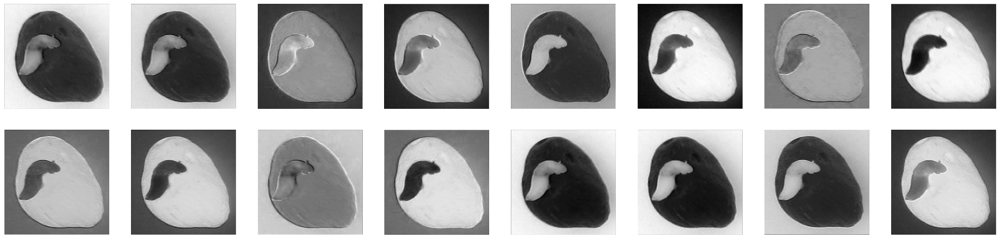

In [ ]:
print("Layer 0 feature maps: \n")
display_layer(0)

#### Visualise Saliency Map

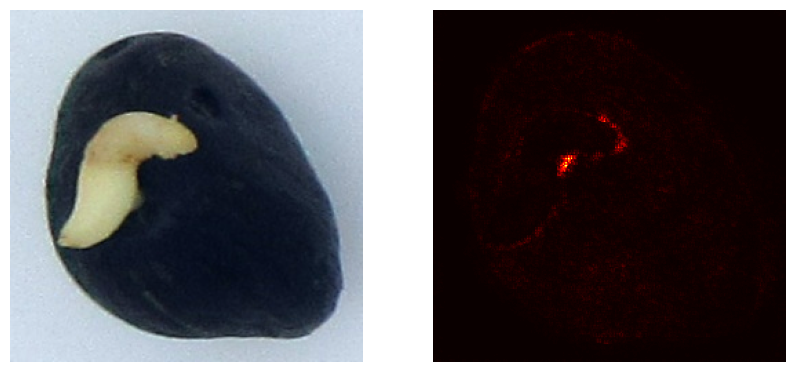

In [ ]:
saliency_map(image_b3)

## Transfer Learning

In [ ]:
import torch
import torchvision.models as models

# Load the pre-trained ResNet-50 model
pre_trained_model = models.resnet50(pretrained=True)

/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:03<00:00, 27.9MB/s]


In [ ]:
# Unfreeze all fc layers
for param in  pre_trained_model.fc.parameters():
    param.requires_grad = True

In [ ]:
# Replace the last fully connected layer
num_ftrs = pre_trained_model.fc.in_features
pre_trained_model.fc = torch.nn.Linear(num_ftrs, 2)

In [ ]:
import torch.optim as optim

criterion = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(pre_trained_model.fc.parameters(), lr=learningRate)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=0.1)

### Training

In [ ]:
train_losses = []
val_losses = []
best_val_accuracy = 0.0
best_val_loss = float('inf')
no_improvement_count = 0
patience = 10 # number of epochs to wait for improvement before stopping

pre_trained_model.to(device)

for epoch in range(numEpoch):
    running_loss = 0.0
    for i, data in enumerate(combined_train_dataloader, 0):
        inputs, labels = data[0].to(device).to(torch.float32), data[1].to(device)

        optimizer.zero_grad()

        outputs = pre_trained_model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

    # Validate the model on the validation set
    pre_trained_model.eval()
    val_loss = 0.0
    val_correct = 0
    val_total = 0
    with torch.no_grad():
        for data in val_dataloader:
            images, labels = data[0].to(device).to(torch.float32), data[1].to(device)
            outputs = pre_trained_model(images)
            _, predicted = torch.max(outputs.data, 1)
            val_total += labels.size(0)
            val_correct += (predicted == labels).sum().item()
            loss = criterion(outputs, labels)
            val_loss += loss.item()

    val_accuracy = 100 * val_correct / val_total
    val_loss /= len(val_dataloader)
    print('Epoch %d -- Train Loss: %.3f | Val Loss: %.3f | Val Acc: %.2f%%' % (epoch + 1, running_loss / len(combined_train_dataloader), val_loss, val_accuracy))

    train_losses.append(running_loss / len(combined_train_dataloader))
    val_losses.append(val_loss)

    if val_loss < best_val_loss:
        best_val_loss = val_loss
        torch.save(pre_trained_model.state_dict(), 'model_tl.pth')
        no_improvement_count = 0
    else:
        no_improvement_count += 1
        if no_improvement_count >= patience:
            print('Early stopping at epoch %d' % (epoch + 1))
            break

    scheduler.step()


Epoch 1 -- Train Loss: 0.545 | Val Loss: 0.510 | Val Acc: 72.65%
Epoch 2 -- Train Loss: 0.388 | Val Loss: 0.389 | Val Acc: 81.48%
Epoch 3 -- Train Loss: 0.343 | Val Loss: 0.369 | Val Acc: 83.48%
Epoch 4 -- Train Loss: 0.322 | Val Loss: 0.336 | Val Acc: 85.47%
Epoch 5 -- Train Loss: 0.296 | Val Loss: 0.315 | Val Acc: 85.75%
Epoch 6 -- Train Loss: 0.278 | Val Loss: 0.321 | Val Acc: 87.18%
Epoch 7 -- Train Loss: 0.271 | Val Loss: 0.314 | Val Acc: 86.61%
Epoch 8 -- Train Loss: 0.256 | Val Loss: 0.315 | Val Acc: 86.61%
Epoch 9 -- Train Loss: 0.273 | Val Loss: 0.292 | Val Acc: 87.75%
Epoch 10 -- Train Loss: 0.245 | Val Loss: 0.290 | Val Acc: 87.46%
Epoch 11 -- Train Loss: 0.232 | Val Loss: 0.322 | Val Acc: 84.62%
Epoch 12 -- Train Loss: 0.235 | Val Loss: 0.285 | Val Acc: 88.03%
Epoch 13 -- Train Loss: 0.226 | Val Loss: 0.282 | Val Acc: 88.32%
Epoch 14 -- Train Loss: 0.228 | Val Loss: 0.278 | Val Acc: 88.89%
Epoch 15 -- Train Loss: 0.216 | Val Loss: 0.276 | Val Acc: 88.03%
Epoch 16 -- Train L

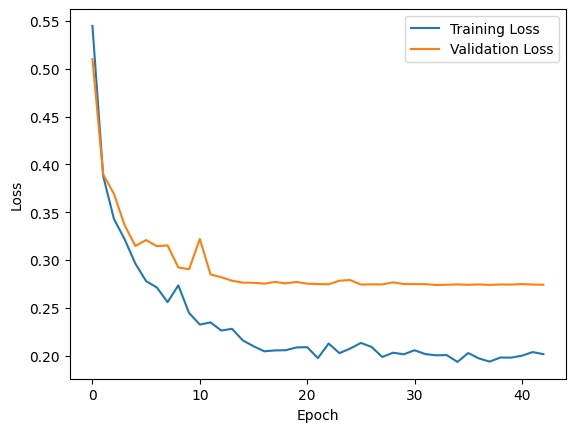

In [ ]:
# Plot the training and validation losses over epochs
plt.plot(train_losses, label='Training Loss')
plt.plot(val_losses, label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

### Batch 1

#### Quantitative Result

In [ ]:
import numpy as np
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix

# Initialize empty lists to store true and predicted labels
true_labels = []
predicted_labels = []

# Evaluate model on test set
# Load pre-trained ResNet50 model
resnet50 = models.resnet50(pretrained=True)

# Replace fc layer with new fc layer
resnet50.fc = torch.nn.Linear(in_features=resnet50.fc.in_features, out_features=2)

# Load state dictionary from saved model
state_dict = torch.load('model_tl.pth')

# Update state dictionary for new fc layer
state_dict['fc.weight'] = state_dict['fc.weight'][:2,:]
state_dict['fc.bias'] = state_dict['fc.bias'][:2]

# Load updated state dictionary into model
resnet50.load_state_dict(state_dict)
resnet50.to(device)
resnet50.eval()

with torch.no_grad():
    for data in test_dataloader:
        images, labels = data[0].to(device).to(torch.float32), data[1].to(device)
        outputs = resnet50(images)
        _, predicted = torch.max(outputs.data, 1)
        predicted_labels += predicted.cpu().numpy().tolist()
        true_labels += labels.cpu().numpy().tolist()

# Compute evaluation metrics
accuracy = accuracy_score(true_labels, predicted_labels)
precision = precision_score(true_labels, predicted_labels, pos_label=1)
recall = recall_score(true_labels, predicted_labels, pos_label=1)
f1 = f1_score(true_labels, predicted_labels, pos_label=1)
auc = roc_auc_score(true_labels, predicted_labels)

# Compute confusion matrix
confusion = confusion_matrix(true_labels, predicted_labels, labels=[1, 0])

# Print evaluation metrics
print('Overall Accuracy: %.2f%%'% (accuracy * 100))
print('Overall Precision: %.2f%%'% (precision * 100))
print('Overall Recall: %.2f%%'% (recall * 100))
print('Overall F1-score: %.2f%%'% (f1 * 100))
print('Overall AUC: %.2f%%'% (auc * 100))
print()

# Print confusion matrix
print('Confusion Matrix:')
print(confusion)
print()

# Calculate precision, recall, accuracy, and F1-score for each class
class_names = ['Good Seed', 'Bad Seed']
metrics = {}
for i in range(len(class_names)):
    TP = confusion[i][i]
    FN = sum(confusion[i]) - TP
    FP = sum(confusion[:, i]) - TP
    TN = sum(sum(confusion)) - TP - FN - FP
    accuracy = (TP + TN) / (TP + TN + FP + FN)
    precision = TP / (TP + FP)
    recall = TP / (TP + FN)
    f1 = 2 * precision * recall / (precision + recall)
    metrics[class_names[i]] = {'Accuracy': accuracy, 'Precision': precision, 'Recall': recall, 'F1-score': f1}

# Print individual metrics
for class_name, class_metrics in metrics.items():
    print(f'{class_name} Metrics:')
    print('---------------------')
    print('Accuracy: %.2f%%' % (class_metrics['Accuracy'] * 100))
    print('Precision: %.2f%%' % (class_metrics['Precision'] * 100))
    print('Recall: %.2f%%' % (class_metrics['Recall'] * 100))
    print('F1-score: %.2f%%' % (class_metrics['F1-score'] * 100))
    print()


Overall Accuracy: 86.03%
Overall Precision: 88.77%
Overall Recall: 82.59%
Overall F1-score: 85.57%
Overall AUC: 86.04%

Confusion Matrix:
[[166  35]
 [ 21 179]]

Good Seed Metrics:
---------------------
Accuracy: 86.03%
Precision: 88.77%
Recall: 82.59%
F1-score: 85.57%

Bad Seed Metrics:
---------------------
Accuracy: 86.03%
Precision: 83.64%
Recall: 89.50%
F1-score: 86.47%



#### Visualise Learned Weights

In [ ]:
model = resnet50

In [ ]:
print(model)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [ ]:
model_weights = [] # we will save the conv layer weights in this list
conv_layers = [] # we will save the conv layers in this list
# get all the model children as list
model_children = list(model.children())

In [ ]:
# counter to keep count of the conv layers
counter = 0 
# append all the conv layers and their respective weights to the list
for i in range(len(model_children)):
    if type(model_children[i]) == nn.Conv2d:
        counter += 1
        model_weights.append(model_children[i].weight)
        conv_layers.append(model_children[i])
    elif type(model_children[i]) == nn.Sequential:
        for j in range(len(model_children[i])):
            for child in model_children[i][j].children():
                if type(child) == nn.Conv2d:
                    counter += 1
                    model_weights.append(child.weight)
                    conv_layers.append(child)
print(f"Total convolutional layers: {counter}")

Total convolutional layers: 49


In [ ]:
# take a look at the conv layers and the respective weights
for weight, conv in zip(model_weights, conv_layers):
    # print(f"WEIGHT: {weight} \nSHAPE: {weight.shape}")
    print(f"CONV: {conv} ====> SHAPE: {weight.shape}")

CONV: Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False) ====> SHAPE: torch.Size([64, 3, 7, 7])
CONV: Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False) ====> SHAPE: torch.Size([64, 64, 1, 1])
CONV: Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False) ====> SHAPE: torch.Size([64, 64, 3, 3])
CONV: Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False) ====> SHAPE: torch.Size([256, 64, 1, 1])
CONV: Conv2d(256, 64, kernel_size=(1, 1), stride=(1, 1), bias=False) ====> SHAPE: torch.Size([64, 256, 1, 1])
CONV: Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False) ====> SHAPE: torch.Size([64, 64, 3, 3])
CONV: Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False) ====> SHAPE: torch.Size([256, 64, 1, 1])
CONV: Conv2d(256, 64, kernel_size=(1, 1), stride=(1, 1), bias=False) ====> SHAPE: torch.Size([64, 256, 1, 1])
CONV: Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False

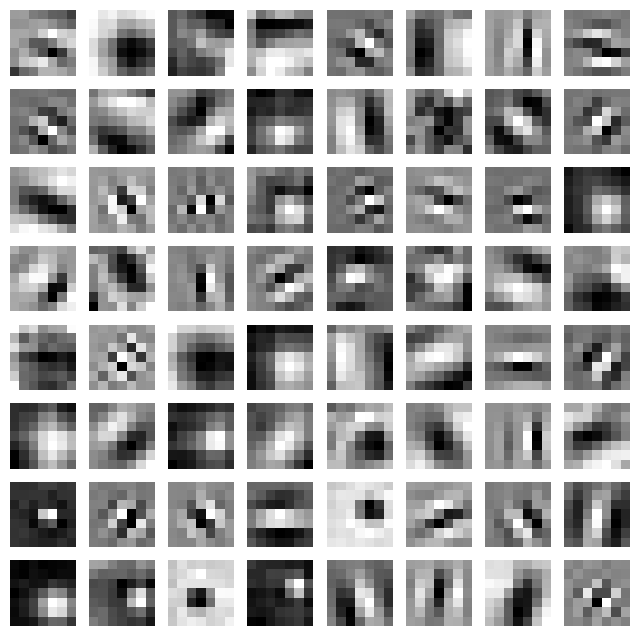

In [ ]:
plt.figure(figsize=(8, 8))
for i, filter in enumerate(model_weights[0]):
    plt.subplot(8, 8, i+1)
    plt.imshow(filter[0, :, :].detach().cpu().numpy(), cmap='gray')
    plt.axis('off')
plt.show()

#### Visualise Feature Map

In [ ]:
# move image tensor to the same device as the weights
image = image.to(next(conv_layers[0].parameters()).device)

# pass the image through all the layers
results = [conv_layers[0](image)]
for i in range(1, len(conv_layers)):
    # pass the result from the last layer to the next layer
    results.append(conv_layers[i](results[-1]))
# make a copy of the `results`
outputs = results

Layer 0 feature maps: 



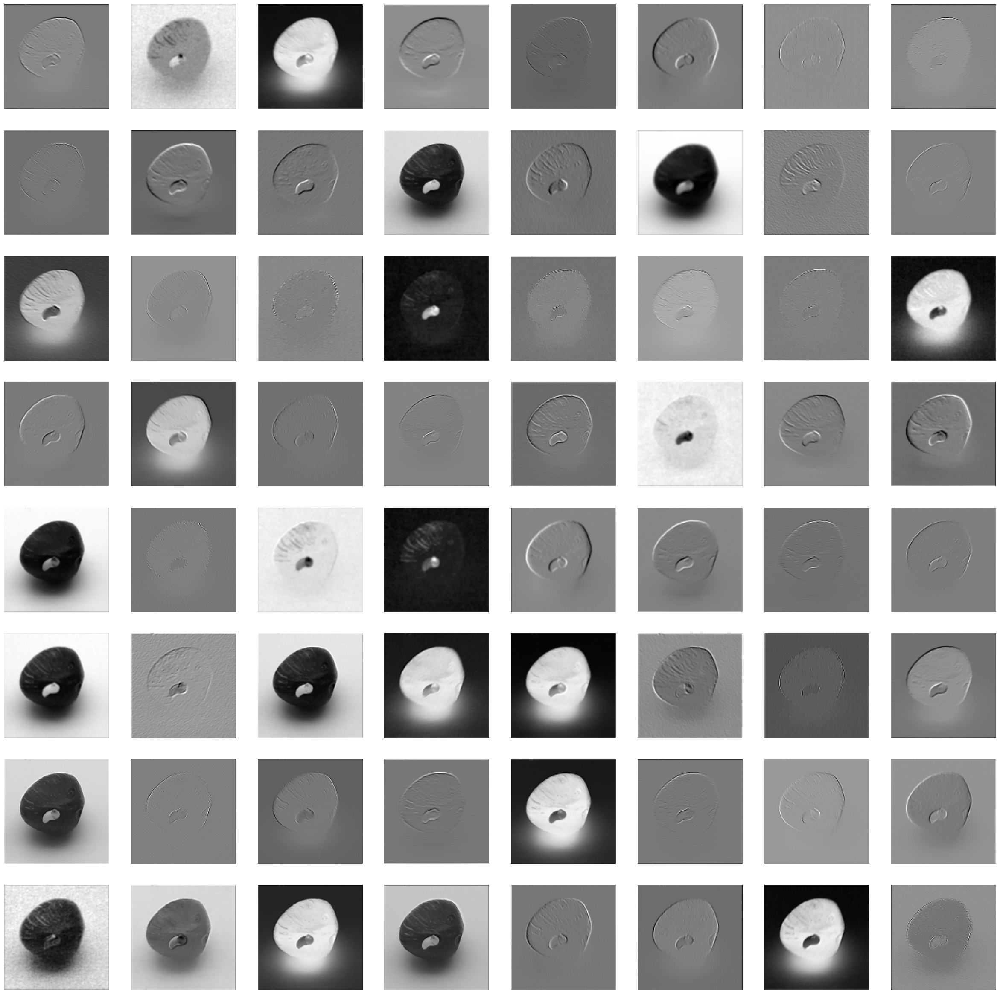

In [ ]:
print("Layer 0 feature maps: \n")
display_layer(0)

#### Visualise Saliency Map

In [ ]:
def saliency_map_t(img):
    device = next(resnet50.parameters()).device # get the device of the model
    X = img.to(device) # move the input image to the same device as the model

    # we would run the model in evaluation mode
    resnet50.eval()

    # we need to find the gradient with respect to the input image, so we need to call requires_grad_ on it
    X.requires_grad_()

    scores = resnet50(X)

    # Get the index corresponding to the maximum score and the maximum score itself.
    score_max_index = scores.argmax()
    score_max = scores[0,score_max_index]

    score_max.backward()

    saliency, _ = torch.max(X.grad.data.abs().cpu(),dim=1)
    img = img.squeeze()
    img_min = img.min()
    img_max = img.max()
    img_norm = (img - img_min) / (img_max - img_min)
    plt.figure(figsize=(10,10))
    plt.subplot(1,2,1)
    plt.imshow(img_norm.cpu().detach().numpy().transpose(1,2,0))
    plt.axis("off")
    plt.subplot(1,2,2)
    plt.imshow(saliency[0], cmap=plt.cm.hot)
    plt.axis("off")
    plt.show()

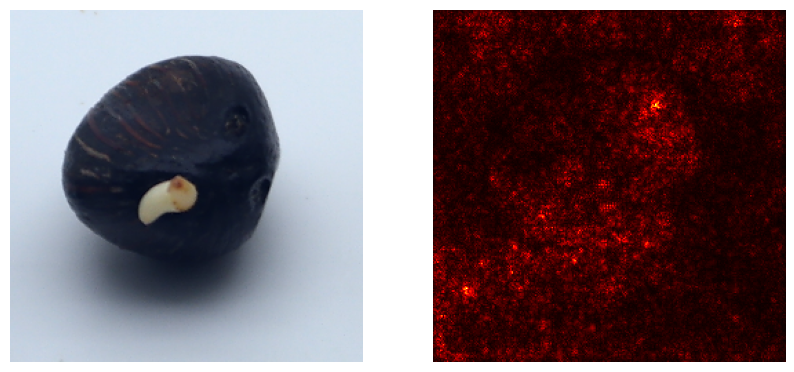

In [ ]:
saliency_map_t(image)

### Batch 2

#### Quantitative Result

In [ ]:
import numpy as np
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix

# Initialize empty lists to store true and predicted labels
true_labels = []
predicted_labels = []

# Evaluate model on test set
# Load pre-trained ResNet50 model
resnet50 = models.resnet50(pretrained=True)

# Replace fc layer with new fc layer
resnet50.fc = torch.nn.Linear(in_features=resnet50.fc.in_features, out_features=2)

# Load state dictionary from saved model
state_dict = torch.load('model_tl.pth')

# Update state dictionary for new fc layer
state_dict['fc.weight'] = state_dict['fc.weight'][:2,:]
state_dict['fc.bias'] = state_dict['fc.bias'][:2]

# Load updated state dictionary into model
resnet50.load_state_dict(state_dict)
resnet50.to(device)
resnet50.eval()

with torch.no_grad():
    for data in b2_dataloader:
        images, labels = data[0].to(device).to(torch.float32), data[1].to(device)
        outputs = resnet50(images)
        _, predicted = torch.max(outputs.data, 1)
        predicted_labels += predicted.cpu().numpy().tolist()
        true_labels += labels.cpu().numpy().tolist()

# Compute evaluation metrics
accuracy = accuracy_score(true_labels, predicted_labels)
precision = precision_score(true_labels, predicted_labels, pos_label=1)
recall = recall_score(true_labels, predicted_labels, pos_label=1)
f1 = f1_score(true_labels, predicted_labels, pos_label=1)
auc = roc_auc_score(true_labels, predicted_labels)

# Compute confusion matrix
confusion = confusion_matrix(true_labels, predicted_labels, labels=[1, 0])

# Print evaluation metrics
print('Overall Accuracy: %.2f%%'% (accuracy * 100))
print('Overall Precision: %.2f%%'% (precision * 100))
print('Overall Recall: %.2f%%'% (recall * 100))
print('Overall F1-score: %.2f%%'% (f1 * 100))
print('Overall AUC: %.2f%%'% (auc * 100))
print()

# Print confusion matrix
print('Confusion Matrix:')
print(confusion)
print()

# Calculate precision, recall, accuracy, and F1-score for each class
class_names = ['Good Seed', 'Bad Seed']
metrics = {}
for i in range(len(class_names)):
    TP = confusion[i][i]
    FN = sum(confusion[i]) - TP
    FP = sum(confusion[:, i]) - TP
    TN = sum(sum(confusion)) - TP - FN - FP
    accuracy = (TP + TN) / (TP + TN + FP + FN)
    precision = TP / (TP + FP)
    recall = TP / (TP + FN)
    f1 = 2 * precision * recall / (precision + recall)
    metrics[class_names[i]] = {'Accuracy': accuracy, 'Precision': precision, 'Recall': recall, 'F1-score': f1}

# Print individual metrics
for class_name, class_metrics in metrics.items():
    print(f'{class_name} Metrics:')
    print('---------------------')
    print('Accuracy: %.2f%%' % (class_metrics['Accuracy'] * 100))
    print('Precision: %.2f%%' % (class_metrics['Precision'] * 100))
    print('Recall: %.2f%%' % (class_metrics['Recall'] * 100))
    print('F1-score: %.2f%%' % (class_metrics['F1-score'] * 100))
    print()


/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Overall Accuracy: 70.56%
Overall Precision: 85.99%
Overall Recall: 49.11%
Overall F1-score: 62.52%
Overall AUC: 70.56%

Confusion Matrix:
[[221 229]
 [ 36 414]]

Good Seed Metrics:
---------------------
Accuracy: 70.56%
Precision: 85.99%
Recall: 49.11%
F1-score: 62.52%

Bad Seed Metrics:
---------------------
Accuracy: 70.56%
Precision: 64.39%
Recall: 92.00%
F1-score: 75.75%



#### Visualise Feature Map

In [ ]:
# move image tensor to the same device as the weights
image_b2 = image_b2.to(next(conv_layers[0].parameters()).device)

# pass the image through all the layers
results = [conv_layers[0](image_b2)]
for i in range(1, len(conv_layers)):
    # pass the result from the last layer to the next layer
    results.append(conv_layers[i](results[-1]))
# make a copy of the `results`
outputs = results

Layer 0 feature maps: 



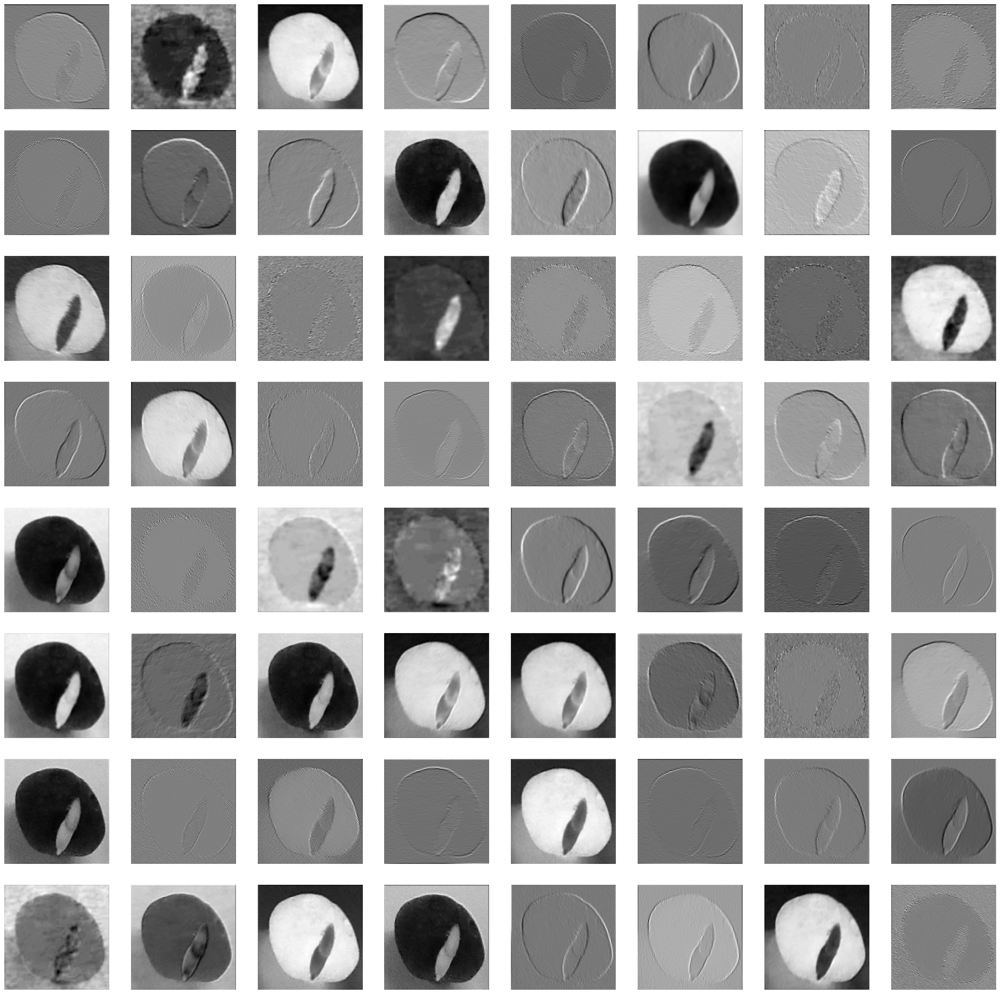

In [ ]:
print("Layer 0 feature maps: \n")
display_layer(0)

#### Visualise Saliency Map

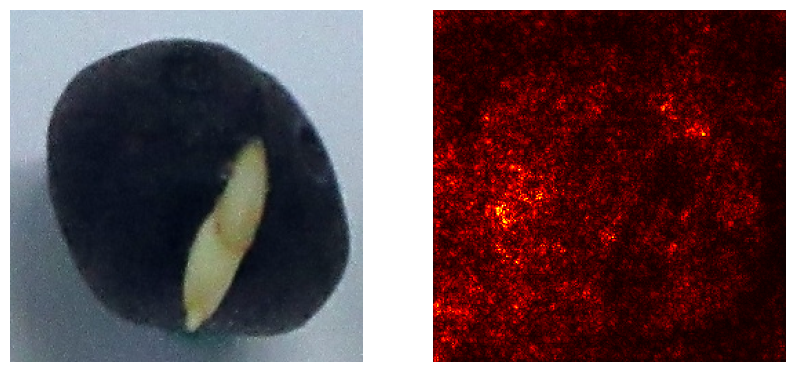

In [ ]:
saliency_map_t(image_b2)

### Batch 3

#### Quantitative Result

In [ ]:
import numpy as np
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix

# Initialize empty lists to store true and predicted labels
true_labels = []
predicted_labels = []

# Evaluate model on test set
# Load pre-trained ResNet50 model
resnet50 = models.resnet50(pretrained=True)

# Replace fc layer with new fc layer
resnet50.fc = torch.nn.Linear(in_features=resnet50.fc.in_features, out_features=2)

# Load state dictionary from saved model
state_dict = torch.load('model_tl.pth')

# Update state dictionary for new fc layer
state_dict['fc.weight'] = state_dict['fc.weight'][:2,:]
state_dict['fc.bias'] = state_dict['fc.bias'][:2]

# Load updated state dictionary into model
resnet50.load_state_dict(state_dict)
resnet50.to(device)
resnet50.eval()

with torch.no_grad():
    for data in b3_dataloader:
        images, labels = data[0].to(device).to(torch.float32), data[1].to(device)
        outputs = resnet50(images)
        _, predicted = torch.max(outputs.data, 1)
        predicted_labels += predicted.cpu().numpy().tolist()
        true_labels += labels.cpu().numpy().tolist()

# Compute evaluation metrics
accuracy = accuracy_score(true_labels, predicted_labels)
precision = precision_score(true_labels, predicted_labels, pos_label=1)
recall = recall_score(true_labels, predicted_labels, pos_label=1)
f1 = f1_score(true_labels, predicted_labels, pos_label=1)
auc = roc_auc_score(true_labels, predicted_labels)

# Compute confusion matrix
confusion = confusion_matrix(true_labels, predicted_labels, labels=[1, 0])

# Print evaluation metrics
print('Overall Accuracy: %.2f%%'% (accuracy * 100))
print('Overall Precision: %.2f%%'% (precision * 100))
print('Overall Recall: %.2f%%'% (recall * 100))
print('Overall F1-score: %.2f%%'% (f1 * 100))
print('Overall AUC: %.2f%%'% (auc * 100))
print()

# Print confusion matrix
print('Confusion Matrix:')
print(confusion)
print()

# Calculate precision, recall, accuracy, and F1-score for each class
class_names = ['Good Seed', 'Bad Seed']
metrics = {}
for i in range(len(class_names)):
    TP = confusion[i][i]
    FN = sum(confusion[i]) - TP
    FP = sum(confusion[:, i]) - TP
    TN = sum(sum(confusion)) - TP - FN - FP
    accuracy = (TP + TN) / (TP + TN + FP + FN)
    precision = TP / (TP + FP)
    recall = TP / (TP + FN)
    f1 = 2 * precision * recall / (precision + recall)
    metrics[class_names[i]] = {'Accuracy': accuracy, 'Precision': precision, 'Recall': recall, 'F1-score': f1}

# Print individual metrics
for class_name, class_metrics in metrics.items():
    print(f'{class_name} Metrics:')
    print('---------------------')
    print('Accuracy: %.2f%%' % (class_metrics['Accuracy'] * 100))
    print('Precision: %.2f%%' % (class_metrics['Precision'] * 100))
    print('Recall: %.2f%%' % (class_metrics['Recall'] * 100))
    print('F1-score: %.2f%%' % (class_metrics['F1-score'] * 100))
    print()


/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Overall Accuracy: 62.77%
Overall Precision: 65.03%
Overall Recall: 56.86%
Overall F1-score: 60.67%
Overall AUC: 62.83%

Confusion Matrix:
[[344 261]
 [185 408]]

Good Seed Metrics:
---------------------
Accuracy: 62.77%
Precision: 65.03%
Recall: 56.86%
F1-score: 60.67%

Bad Seed Metrics:
---------------------
Accuracy: 62.77%
Precision: 60.99%
Recall: 68.80%
F1-score: 64.66%



#### Visualise Feature Map

In [ ]:
# move image tensor to the same device as the weights
image_b3 = image_b3.to(next(conv_layers[0].parameters()).device)

# pass the image through all the layers
results = [conv_layers[0](image_b3)]
for i in range(1, len(conv_layers)):
    # pass the result from the last layer to the next layer
    results.append(conv_layers[i](results[-1]))
# make a copy of the `results`
outputs = results

Layer 0 feature maps: 



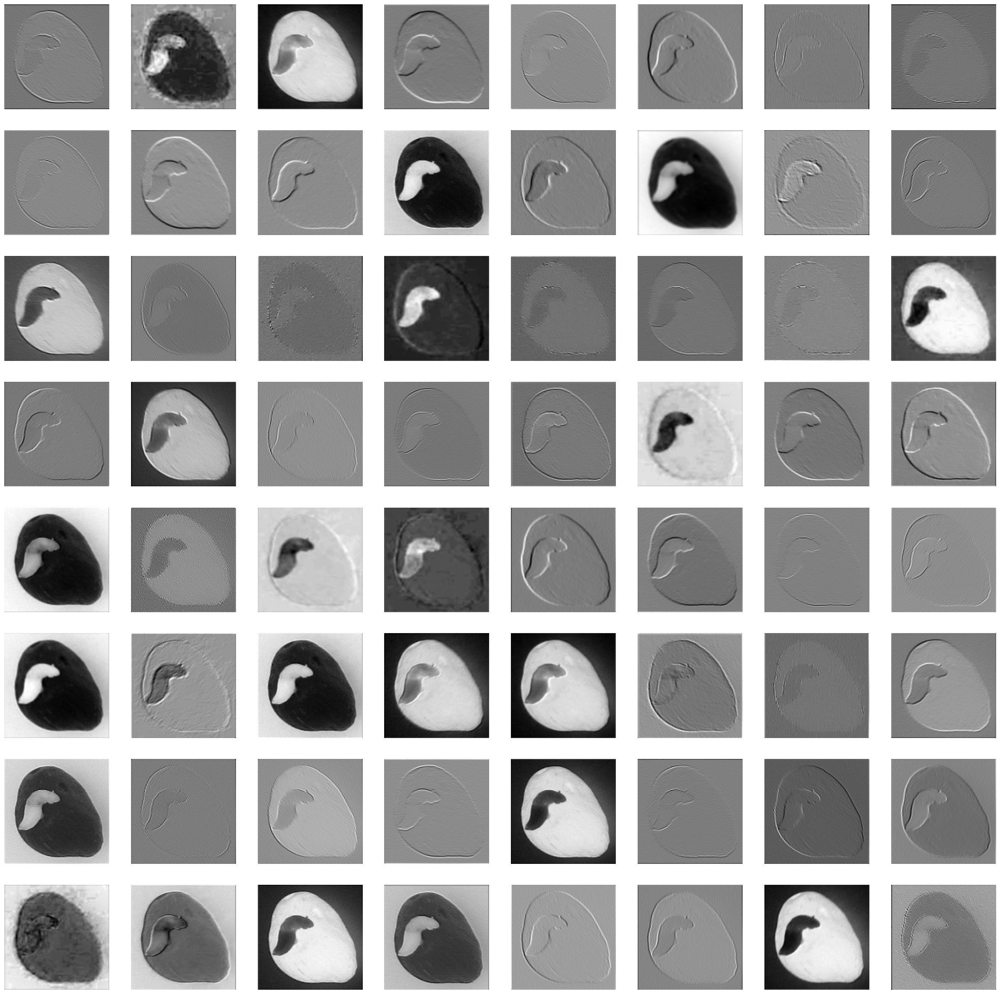


Layer 1 feature maps: 



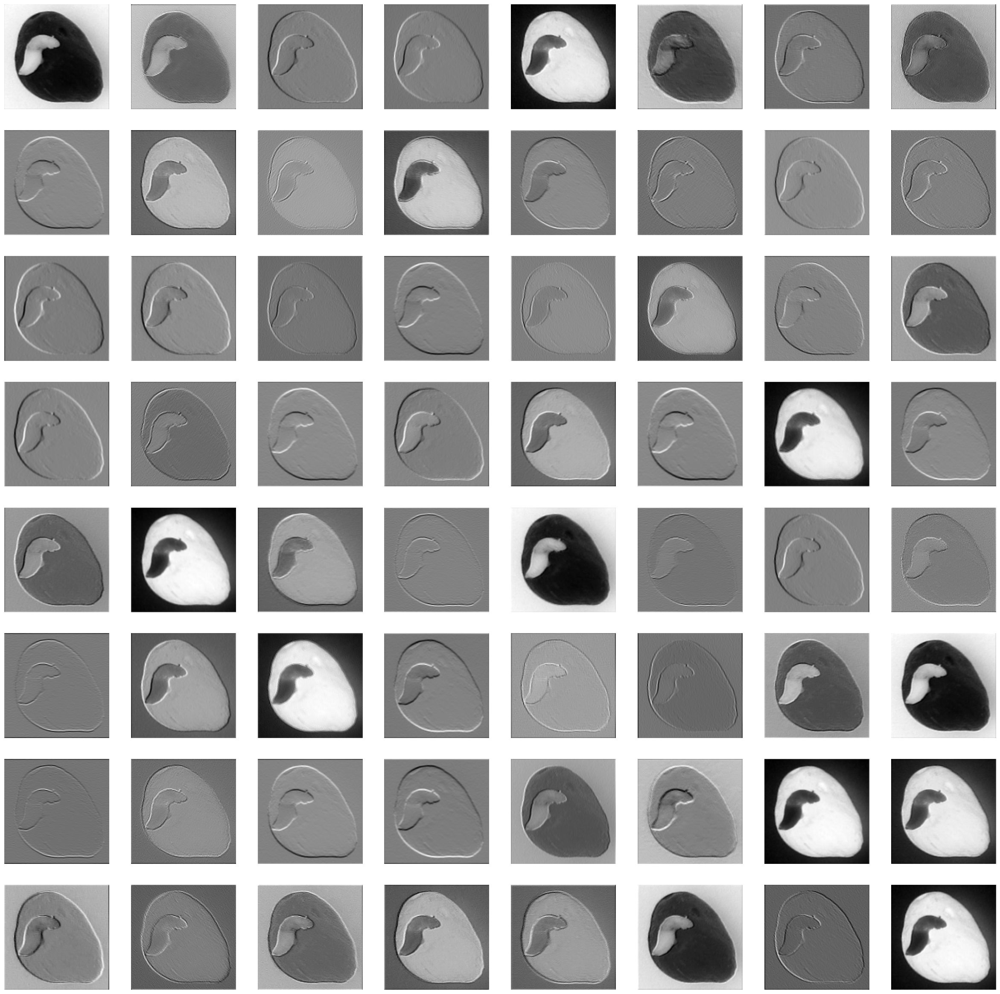


Layer 2 feature maps: 



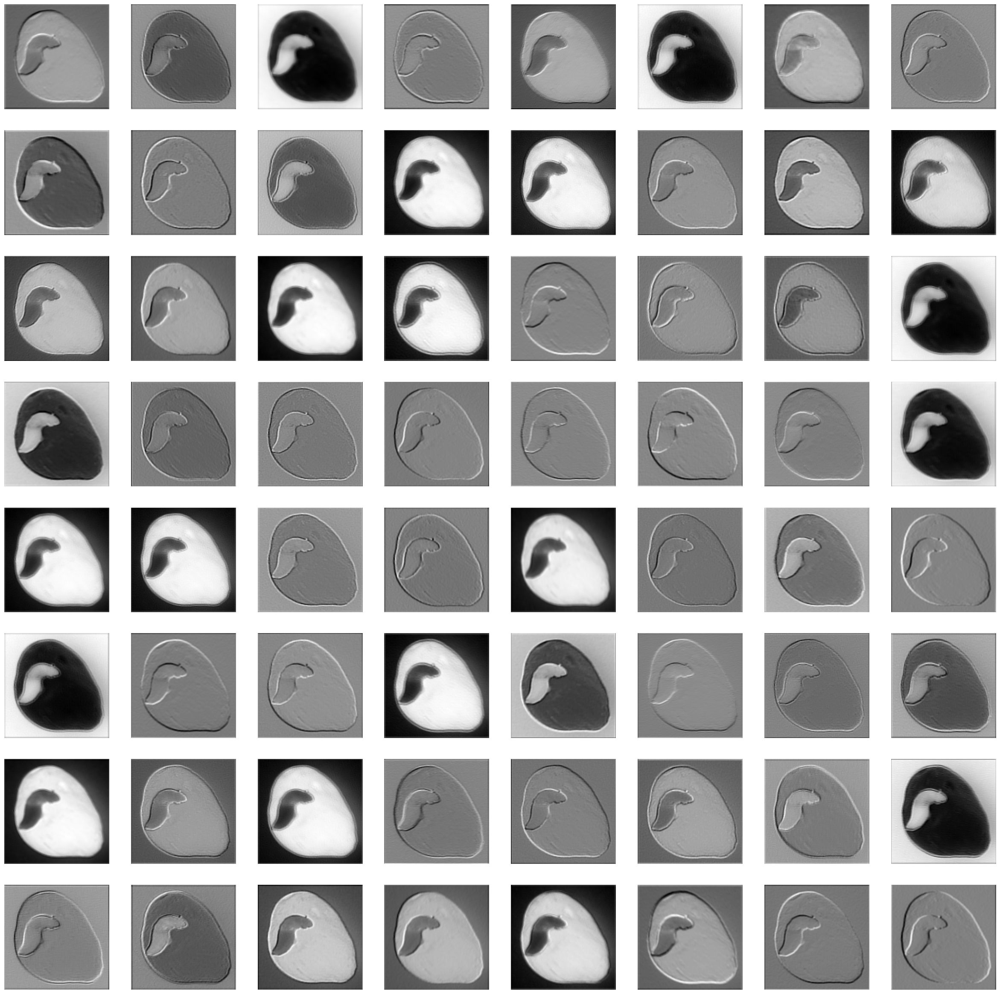

In [ ]:
print("Layer 0 feature maps: \n")
display_layer(0)

print("Layer 1 feature maps: \n")
display_layer(1)

print("Layer 2 feature maps: \n")
display_layer(2)

#### Visualise Saliency Map

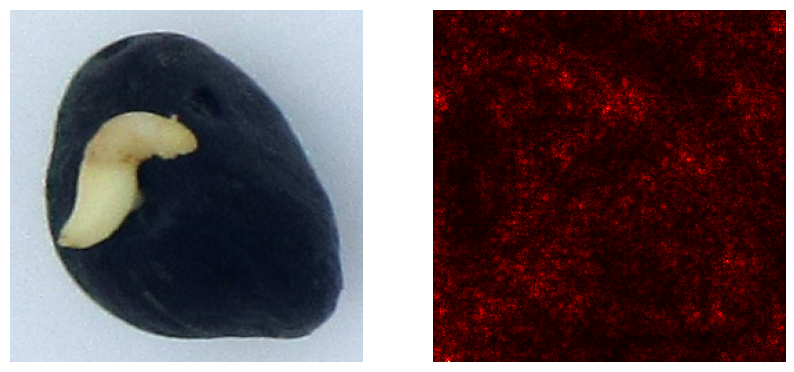

In [ ]:
saliency_map_t(image_b3)

## Solution

### Data Splitting

In [ ]:
from sklearn.model_selection import train_test_split
b2_train_val, b2_test = train_test_split(b2_data, test_size=0.7, random_state=42)
b3_train_val, b3_test = train_test_split(b3_data, test_size=0.7, random_state=42)

In [ ]:
b2_train, b2_val = train_test_split(b2_train_val, test_size=0.3, random_state=42)
b3_train, b3_val = train_test_split(b3_train_val, test_size=0.3, random_state=42)

In [ ]:
solution_train = torch.utils.data.ConcatDataset([training_data, b2_train, b3_train])

In [ ]:
solution_val = torch.utils.data.ConcatDataset([val_data, b2_val, b3_val])

In [ ]:
solution_size = len(solution_train)
print(f'Solution Training Data Size: {solution_size}')

Solution Training Data Size: 1841


In [ ]:
solution_train_dataloader = DataLoader(solution_train, batch_size=32, shuffle=True, num_workers=2)

In [ ]:
solution_val_dataloader = DataLoader(solution_val, batch_size=32, shuffle=True, num_workers=2)

In [ ]:
b2_testloader = DataLoader(b2_test, batch_size=32, shuffle=False, num_workers=2)
b3_testloader = DataLoader(b3_test, batch_size=32, shuffle=False, num_workers=2)

### Training

In [ ]:
import torch
import torchvision.models as models
import torch.optim as optim

In [ ]:
# Load the pre-trained ResNet-50 model
pre_trained_model = models.resnet50(pretrained=True)

# Unfreeze all fc layer
for param in  pre_trained_model.fc.parameters():
    param.requires_grad = True

# Replace the last fully connected layer
num_ftrs = pre_trained_model.fc.in_features
pre_trained_model.fc = torch.nn.Linear(num_ftrs, 2)

criterion = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(pre_trained_model.fc.parameters(), lr=learningRate)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=0.1)

/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [ ]:
train_losses = []
val_losses = []
best_val_accuracy = 0.0
best_val_loss = float('inf')
no_improvement_count = 0
patience = 10 # number of epochs to wait for improvement before stopping

pre_trained_model.to(device)

for epoch in range(numEpoch):
    running_loss = 0.0
    for i, data in enumerate(solution_train_dataloader, 0):
        inputs, labels = data[0].to(device).to(torch.float32), data[1].to(device)

        optimizer.zero_grad()

        outputs = pre_trained_model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

    # Validate the model on the validation set
    pre_trained_model.eval()
    val_loss = 0.0
    val_correct = 0
    val_total = 0
    with torch.no_grad():
        for data in solution_val_dataloader:
            images, labels = data[0].to(device).to(torch.float32), data[1].to(device)
            outputs = pre_trained_model(images)
            _, predicted = torch.max(outputs.data, 1)
            val_total += labels.size(0)
            val_correct += (predicted == labels).sum().item()
            loss = criterion(outputs, labels)
            val_loss += loss.item()

    val_accuracy = 100 * val_correct / val_total
    val_loss /= len(solution_val_dataloader)
    print('Epoch %d -- Train Loss: %.3f | Val Loss: %.3f | Val Acc: %.2f%%' % (epoch + 1, running_loss / len(solution_train_dataloader), val_loss, val_accuracy))

    train_losses.append(running_loss / len(solution_train_dataloader))
    val_losses.append(val_loss)

    if val_loss < best_val_loss:
        best_val_loss = val_loss
        torch.save(pre_trained_model.state_dict(), 'solution_tl.pth')
        no_improvement_count = 0
    else:
        no_improvement_count += 1
        if no_improvement_count >= patience:
            print('Early stopping at epoch %d' % (epoch + 1))
            break

    scheduler.step()


Epoch 1 -- Train Loss: 0.648 | Val Loss: 0.551 | Val Acc: 73.52%
Epoch 2 -- Train Loss: 0.476 | Val Loss: 0.480 | Val Acc: 76.67%
Epoch 3 -- Train Loss: 0.412 | Val Loss: 0.443 | Val Acc: 77.78%
Epoch 4 -- Train Loss: 0.385 | Val Loss: 0.423 | Val Acc: 80.00%
Epoch 5 -- Train Loss: 0.354 | Val Loss: 0.413 | Val Acc: 79.81%
Epoch 6 -- Train Loss: 0.342 | Val Loss: 0.391 | Val Acc: 83.15%
Epoch 7 -- Train Loss: 0.320 | Val Loss: 0.407 | Val Acc: 80.56%
Epoch 8 -- Train Loss: 0.319 | Val Loss: 0.399 | Val Acc: 80.00%
Epoch 9 -- Train Loss: 0.304 | Val Loss: 0.373 | Val Acc: 83.33%
Epoch 10 -- Train Loss: 0.299 | Val Loss: 0.398 | Val Acc: 80.74%
Epoch 11 -- Train Loss: 0.301 | Val Loss: 0.362 | Val Acc: 83.89%
Epoch 12 -- Train Loss: 0.287 | Val Loss: 0.441 | Val Acc: 79.63%
Epoch 13 -- Train Loss: 0.294 | Val Loss: 0.373 | Val Acc: 82.22%
Epoch 14 -- Train Loss: 0.270 | Val Loss: 0.358 | Val Acc: 84.44%
Epoch 15 -- Train Loss: 0.270 | Val Loss: 0.350 | Val Acc: 84.81%
Epoch 16 -- Train L

### Batch 2

#### Quantitative Result

In [ ]:
import numpy as np
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix

# Initialize empty lists to store true and predicted labels
true_labels = []
predicted_labels = []

# Evaluate model on test set
# Load pre-trained ResNet50 model
resnet50 = models.resnet50(pretrained=True)

# Replace fc layer with new fc layer
resnet50.fc = torch.nn.Linear(in_features=resnet50.fc.in_features, out_features=2)

# Load state dictionary from saved model
state_dict = torch.load('solution_tl.pth')

# Update state dictionary for new fc layer
state_dict['fc.weight'] = state_dict['fc.weight'][:2,:]
state_dict['fc.bias'] = state_dict['fc.bias'][:2]

# Load updated state dictionary into model
resnet50.load_state_dict(state_dict)
resnet50.to(device)
resnet50.eval()

with torch.no_grad():
    for data in b2_testloader:
        images, labels = data[0].to(device).to(torch.float32), data[1].to(device)
        outputs = resnet50(images)
        _, predicted = torch.max(outputs.data, 1)
        predicted_labels += predicted.cpu().numpy().tolist()
        true_labels += labels.cpu().numpy().tolist()

# Compute evaluation metrics
accuracy = accuracy_score(true_labels, predicted_labels)
precision = precision_score(true_labels, predicted_labels, pos_label=1)
recall = recall_score(true_labels, predicted_labels, pos_label=1)
f1 = f1_score(true_labels, predicted_labels, pos_label=1)
auc = roc_auc_score(true_labels, predicted_labels)

# Compute confusion matrix
confusion = confusion_matrix(true_labels, predicted_labels, labels=[1, 0])

# Print evaluation metrics
print('Overall Accuracy: %.2f%%'% (accuracy * 100))
print('Overall Precision: %.2f%%'% (precision * 100))
print('Overall Recall: %.2f%%'% (recall * 100))
print('Overall F1-score: %.2f%%'% (f1 * 100))
print('Overall AUC: %.2f%%'% (auc * 100))
print()

# Print confusion matrix
print('Confusion Matrix:')
print(confusion)
print()

# Calculate precision, recall, accuracy, and F1-score for each class
class_names = ['Good Seed', 'Bad Seed']
metrics = {}
for i in range(len(class_names)):
    TP = confusion[i][i]
    FN = sum(confusion[i]) - TP
    FP = sum(confusion[:, i]) - TP
    TN = sum(sum(confusion)) - TP - FN - FP
    accuracy = (TP + TN) / (TP + TN + FP + FN)
    precision = TP / (TP + FP)
    recall = TP / (TP + FN)
    f1 = 2 * precision * recall / (precision + recall)
    metrics[class_names[i]] = {'Accuracy': accuracy, 'Precision': precision, 'Recall': recall, 'F1-score': f1}

# Print individual metrics
for class_name, class_metrics in metrics.items():
    print(f'{class_name} Metrics:')
    print('---------------------')
    print('Accuracy: %.2f%%' % (class_metrics['Accuracy'] * 100))
    print('Precision: %.2f%%' % (class_metrics['Precision'] * 100))
    print('Recall: %.2f%%' % (class_metrics['Recall'] * 100))
    print('F1-score: %.2f%%' % (class_metrics['F1-score'] * 100))
    print()


Overall Accuracy: 84.44%
Overall Precision: 85.85%
Overall Recall: 83.74%
Overall F1-score: 84.78%
Overall AUC: 84.47%

Confusion Matrix:
[[273  53]
 [ 45 259]]

Good Seed Metrics:
---------------------
Accuracy: 84.44%
Precision: 85.85%
Recall: 83.74%
F1-score: 84.78%

Bad Seed Metrics:
---------------------
Accuracy: 84.44%
Precision: 83.01%
Recall: 85.20%
F1-score: 84.09%



#### Visualise Learned Weights

In [ ]:
model = resnet50

In [ ]:
model_weights = [] # we will save the conv layer weights in this list
conv_layers = [] # we will save the conv layers in this list
# get all the model children as list
model_children = list(model.children())

In [ ]:
# counter to keep count of the conv layers
counter = 0 
# append all the conv layers and their respective weights to the list
for i in range(len(model_children)):
    if type(model_children[i]) == nn.Conv2d:
        counter += 1
        model_weights.append(model_children[i].weight)
        conv_layers.append(model_children[i])
    elif type(model_children[i]) == nn.Sequential:
        for j in range(len(model_children[i])):
            for child in model_children[i][j].children():
                if type(child) == nn.Conv2d:
                    counter += 1
                    model_weights.append(child.weight)
                    conv_layers.append(child)
print(f"Total convolutional layers: {counter}")

Total convolutional layers: 49


In [ ]:
# take a look at the conv layers and the respective weights
for weight, conv in zip(model_weights, conv_layers):
    # print(f"WEIGHT: {weight} \nSHAPE: {weight.shape}")
    print(f"CONV: {conv} ====> SHAPE: {weight.shape}")

CONV: Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False) ====> SHAPE: torch.Size([64, 3, 7, 7])
CONV: Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False) ====> SHAPE: torch.Size([64, 64, 1, 1])
CONV: Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False) ====> SHAPE: torch.Size([64, 64, 3, 3])
CONV: Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False) ====> SHAPE: torch.Size([256, 64, 1, 1])
CONV: Conv2d(256, 64, kernel_size=(1, 1), stride=(1, 1), bias=False) ====> SHAPE: torch.Size([64, 256, 1, 1])
CONV: Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False) ====> SHAPE: torch.Size([64, 64, 3, 3])
CONV: Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False) ====> SHAPE: torch.Size([256, 64, 1, 1])
CONV: Conv2d(256, 64, kernel_size=(1, 1), stride=(1, 1), bias=False) ====> SHAPE: torch.Size([64, 256, 1, 1])
CONV: Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False

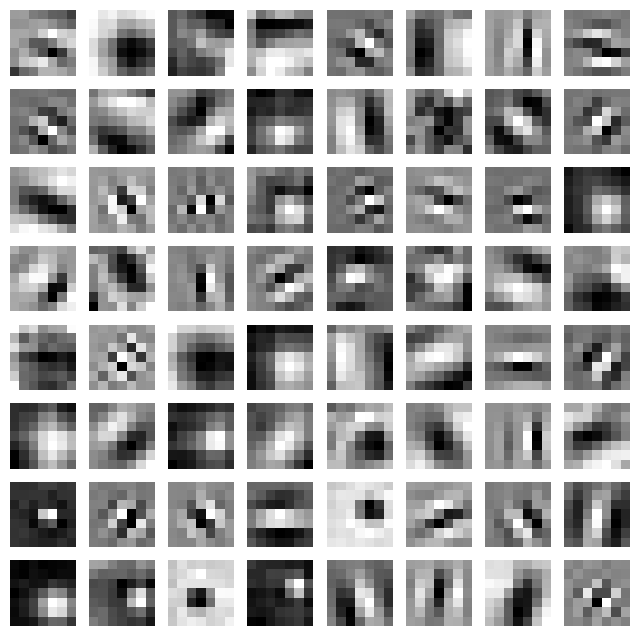

In [ ]:
plt.figure(figsize=(8, 8))
for i, filter in enumerate(model_weights[0]):
    plt.subplot(8, 8, i+1)
    plt.imshow(filter[0, :, :].detach().cpu().numpy(), cmap='gray')
    plt.axis('off')
plt.show()

#### Visualise Feature Map

In [ ]:
# move image tensor to the same device as the weights
image_b2 = image_b2.to(next(conv_layers[0].parameters()).device)

# pass the image through all the layers
results = [conv_layers[0](image_b2)]
for i in range(1, len(conv_layers)):
    # pass the result from the last layer to the next layer
    results.append(conv_layers[i](results[-1]))
# make a copy of the `results`
outputs = results

Layer 0 feature maps: 



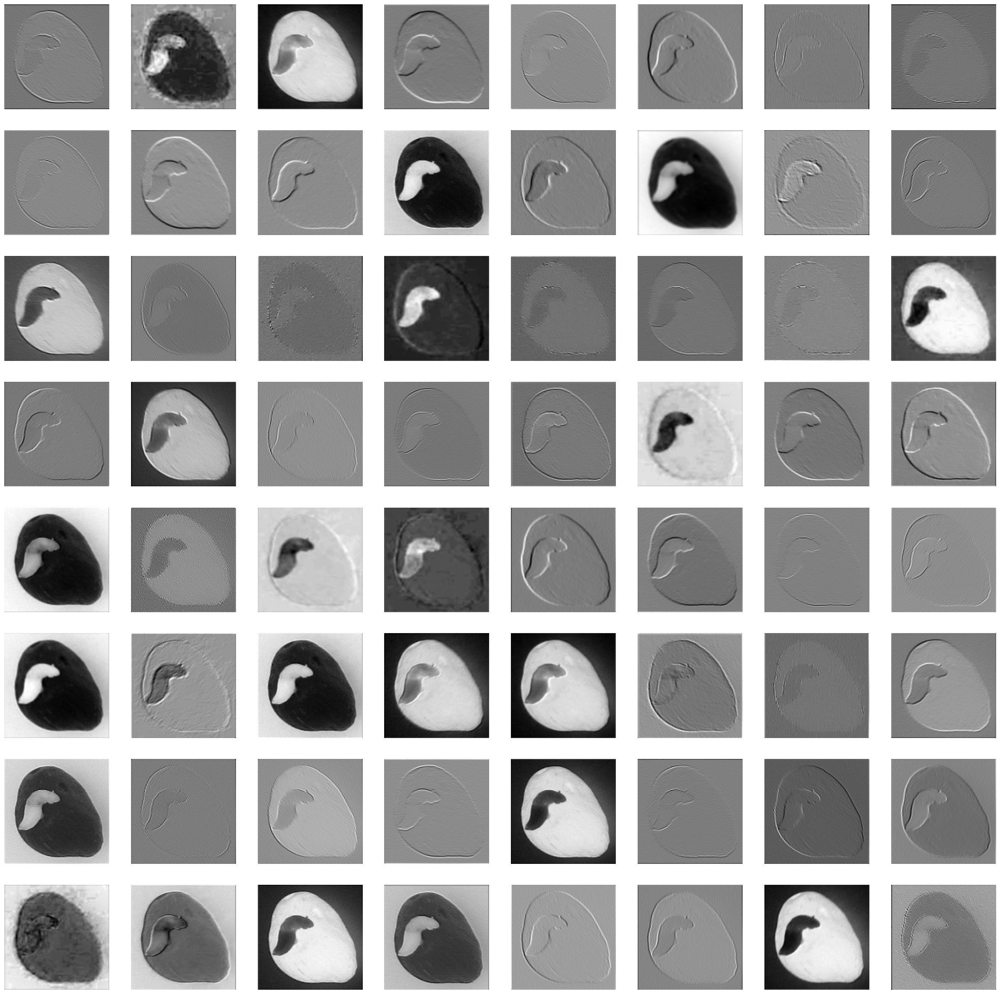

In [ ]:
print("Layer 0 feature maps: \n")
display_layer(0)

#### Visualise Saliency Map

In [ ]:
saliency_map_t(image_b2)

### Batch 3

#### Quantitative Result

In [ ]:
import numpy as np
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix

# Initialize empty lists to store true and predicted labels
true_labels = []
predicted_labels = []

# Evaluate model on test set
# Load pre-trained ResNet50 model
resnet50 = models.resnet50(pretrained=True)

# Replace fc layer with new fc layer
resnet50.fc = torch.nn.Linear(in_features=resnet50.fc.in_features, out_features=2)

# Load state dictionary from saved model
state_dict = torch.load('solution_tl.pth')

# Update state dictionary for new fc layer
state_dict['fc.weight'] = state_dict['fc.weight'][:2,:]
state_dict['fc.bias'] = state_dict['fc.bias'][:2]

# Load updated state dictionary into model
resnet50.load_state_dict(state_dict)
resnet50.to(device)
resnet50.eval()

with torch.no_grad():
    for data in b3_testloader:
        images, labels = data[0].to(device).to(torch.float32), data[1].to(device)
        outputs = resnet50(images)
        _, predicted = torch.max(outputs.data, 1)
        predicted_labels += predicted.cpu().numpy().tolist()
        true_labels += labels.cpu().numpy().tolist()

# Compute evaluation metrics
accuracy = accuracy_score(true_labels, predicted_labels)
precision = precision_score(true_labels, predicted_labels, pos_label=1)
recall = recall_score(true_labels, predicted_labels, pos_label=1)
f1 = f1_score(true_labels, predicted_labels, pos_label=1)
auc = roc_auc_score(true_labels, predicted_labels)

# Compute confusion matrix
confusion = confusion_matrix(true_labels, predicted_labels, labels=[1, 0])

# Print evaluation metrics
print('Overall Accuracy: %.2f%%'% (accuracy * 100))
print('Overall Precision: %.2f%%'% (precision * 100))
print('Overall Recall: %.2f%%'% (recall * 100))
print('Overall F1-score: %.2f%%'% (f1 * 100))
print('Overall AUC: %.2f%%'% (auc * 100))
print()

# Print confusion matrix
print('Confusion Matrix:')
print(confusion)
print()

# Calculate precision, recall, accuracy, and F1-score for each class
class_names = ['Good Seed', 'Bad Seed']
metrics = {}
for i in range(len(class_names)):
    TP = confusion[i][i]
    FN = sum(confusion[i]) - TP
    FP = sum(confusion[:, i]) - TP
    TN = sum(sum(confusion)) - TP - FN - FP
    accuracy = (TP + TN) / (TP + TN + FP + FN)
    precision = TP / (TP + FP)
    recall = TP / (TP + FN)
    f1 = 2 * precision * recall / (precision + recall)
    metrics[class_names[i]] = {'Accuracy': accuracy, 'Precision': precision, 'Recall': recall, 'F1-score': f1}

# Print individual metrics
for class_name, class_metrics in metrics.items():
    print(f'{class_name} Metrics:')
    print('---------------------')
    print('Accuracy: %.2f%%' % (class_metrics['Accuracy'] * 100))
    print('Precision: %.2f%%' % (class_metrics['Precision'] * 100))
    print('Recall: %.2f%%' % (class_metrics['Recall'] * 100))
    print('F1-score: %.2f%%' % (class_metrics['F1-score'] * 100))
    print()


#### Visualise Feature Map

In [ ]:
# move image tensor to the same device as the weights
image_b3 = image_b3.to(next(conv_layers[0].parameters()).device)

# pass the image through all the layers
results = [conv_layers[0](image_b3)]
for i in range(1, len(conv_layers)):
    # pass the result from the last layer to the next layer
    results.append(conv_layers[i](results[-1]))
# make a copy of the `results`
outputs = results

In [ ]:
print("Layer 0 feature maps: \n")
display_layer(0)

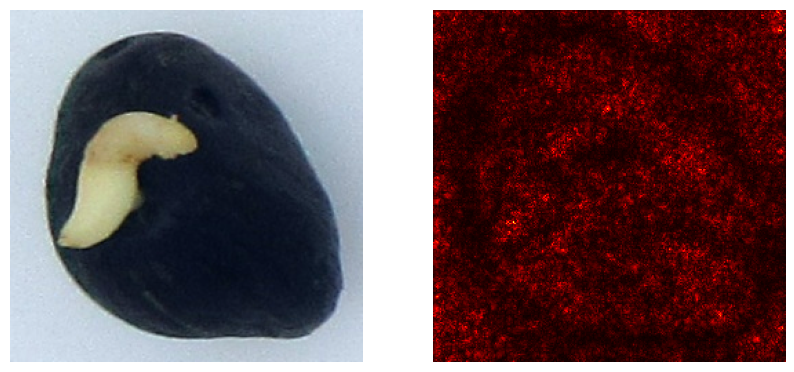

In [ ]:
saliency_map_t(image_b3)